# FINAL PROJECT 1 (Group 6)
- Kelas		    : KS-015
- Program	    : Python for Data Science

Anggota:
1.  - Nama          : Annisa Nur Hidayah
    - Kode peserta  : PYTN-KS15-002
2.  - Nama          : Lisa Wahyu Ningsih
    - Kode peserta  : PYTN-KS15-007
3.  - Nama          : Nadilla Nur 'Aini Yulian Putri
    - Kode peserta  : PYTN-KS15-012

## Introduction

Project ini berisi tentang Linear Regression pada dataset Rideshare yang dapat diakses melalui laman https://www.kaggle.com/datasets/brllrb/uber-and-lyft-dataset-boston-ma . Data ini mengandung 57 kolom yang merupakan dataset yang cocok untuk menggunakan model Linear Regression dalam melihat pola antara predector yang berbeda seperti jam dan harga. Juga data cuaca, suhu, angin, dan matahari tenggelam yang termasuk dalam faktor penting lainnya.

## Import Library

In [1]:
import numpy as np
import pandas as pd
import seaborn as sns
import matplotlib as mpl
import matplotlib.pyplot as plt
import geopandas as gpd
import folium

from folium.plugins import FastMarkerCluster
from sklearn import preprocessing
from sklearn.preprocessing import StandardScaler
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LinearRegression
from sklearn.metrics import r2_score
from sklearn.metrics import mean_squared_error

mpl.style.use(['ggplot']) # optional: for ggplot-like style

%matplotlib inline

In [2]:
pd.options.display.max_rows = None
pd.options.display.max_columns = None

## Data Loading

In [3]:
rideshare = pd.read_csv('dataset\\rideshare_kaggle.csv')

In [4]:
# Menyalin dataset
df = rideshare.copy()

In [5]:
# Menampilkan 5 data pertama
df.head()

,id,timestamp,hour,day,month,datetime,timezone,source,destination,cab_type,product_id,name,price,distance,surge_multiplier,latitude,longitude,temperature,apparentTemperature,short_summary,long_summary,precipIntensity,precipProbability,humidity,windSpeed,windGust,windGustTime,visibility,temperatureHigh,temperatureHighTime,temperatureLow,temperatureLowTime,apparentTemperatureHigh,apparentTemperatureHighTime,apparentTemperatureLow,apparentTemperatureLowTime,icon,dewPoint,pressure,windBearing,cloudCover,uvIndex,visibility.1,ozone,sunriseTime,sunsetTime,moonPhase,precipIntensityMax,uvIndexTime,temperatureMin,temperatureMinTime,temperatureMax,temperatureMaxTime,apparentTemperatureMin,apparentTemperatureMinTime,apparentTemperatureMax,apparentTemperatureMaxTime
0,424553bb-7174-41ea-aeb4-fe06d4f4b9d7,1.544953e+09,9,16,12,2018-12-16 09:30:07,America/New_York,Haymarket Square,North Station,Lyft,lyft_line,Shared,5.0,0.44,1.0,42.2148,-71.033,42.34,37.12,Mostly Cloudy,Rain throughout the day.,0.0000,0.0,0.68,8.66,9.17,1545015600,10.000,43.68,1544968800,34.19,1545048000,37.95,1544968800,27.39,1545044400,partly-cloudy-night,32.70,1021.98,57,0.72,0,10.000,303.8,1544962084,1544994864,0.30,0.1276,1544979600,39.89,1545012000,43.68,1544968800,33.73,1545012000,38.07,1544958000
1,4bd23055-6827-41c6-b23b-3c491f24e74d,1.543284e+09,2,27,11,2018-11-27 02:00:23,America/New_York,Haymarket Square,North Station,Lyft,lyft_premier,Lux,11.0,0.44,1.0,42.2148,-71.033,43.58,37.35,Rain,"Rain until morning, starting again in the eve...",0.1299,1.0,0.94,11.98,11.98,1543291200,4.786,47.30,1543251600,42.10,1543298400,43.92,1543251600,36.20,1543291200,rain,41.83,1003.97,90,1.00,0,4.786,291.1,1543232969,1543266992,0.64,0.1300,1543251600,40.49,1543233600,47.30,1543251600,36.20,1543291200,43.92,1543251600
2,981a3613-77af-4620-a42a-0c0866077d1e,1.543367e+09,1,28,11,2018-11-28 01:00:22,America/New_York,Haymarket Square,North Station,Lyft,lyft,Lyft,7.0,0.44,1.0,42.2148,-71.033,38.33,32.93,Clear,Light rain in the morning.,0.0000,0.0,0.75,7.33,7.33,1543334400,10.000,47.55,1543320000,33.10,1543402800,44.12,1543320000,29.11,1543392000,clear-night,31.10,992.28,240,0.03,0,10.000,315.7,1543319437,1543353364,0.68,0.1064,1543338000,35.36,1543377600,47.55,1543320000,31.04,1543377600,44.12,1543320000
3,c2d88af2-d278-4bfd-a8d0-29ca77cc5512,1.543554e+09,4,30,11,2018-11-30 04:53:02,America/New_York,Haymarket Square,North Station,Lyft,lyft_luxsuv,Lux Black XL,26.0,0.44,1.0,42.2148,-71.033,34.38,29.63,Clear,Partly cloudy throughout the day.,0.0000,0.0,0.73,5.28,5.28,1543514400,10.000,45.03,1543510800,28.90,1543579200,38.53,1543510800,26.20,1543575600,clear-night,26.64,1013.73,310,0.00,0,10.000,291.1,1543492370,1543526114,0.75,0.0000,1543507200,34.67,1543550400,45.03,1543510800,30.30,1543550400,38.53,1543510800
4,e0126e1f-8ca9-4f2e-82b3-50505a09db9a,1.543463e+09,3,29,11,2018-11-29 03:49:20,America/New_York,Haymarket Square,North Station,Lyft,lyft_plus,Lyft XL,9.0,0.44,1.0,42.2148,-71.033,37.44,30.88,Partly Cloudy,Mostly cloudy throughout the day.,0.0000,0.0,0.70,9.14,9.14,1543446000,10.000,42.18,1543420800,36.71,1543478400,35.75,1543420800,30.29,1543460400,partly-cloudy-night,28.61,998.36,303,0.44,0,10.000,347.7,1543405904,1543439738,0.72,0.0001,1543420800,33.10,1543402800,42.18,1543420800,29.11,1543392000,35.75,1543420800


In [6]:
# Menampilkan 5 data terakhir
df.tail()

,id,timestamp,hour,day,month,datetime,timezone,source,destination,cab_type,product_id,name,price,distance,surge_multiplier,latitude,longitude,temperature,apparentTemperature,short_summary,long_summary,precipIntensity,precipProbability,humidity,windSpeed,windGust,windGustTime,visibility,temperatureHigh,temperatureHighTime,temperatureLow,temperatureLowTime,apparentTemperatureHigh,apparentTemperatureHighTime,apparentTemperatureLow,apparentTemperatureLowTime,icon,dewPoint,pressure,windBearing,cloudCover,uvIndex,visibility.1,ozone,sunriseTime,sunsetTime,moonPhase,precipIntensityMax,uvIndexTime,temperatureMin,temperatureMinTime,temperatureMax,temperatureMaxTime,apparentTemperatureMin,apparentTemperatureMinTime,apparentTemperatureMax,apparentTemperatureMaxTime
693066,616d3611-1820-450a-9845-a9ff304a4842,1.543708e+09,23,1,12,2018-12-01 23:53:05,America/New_York,West End,North End,Uber,6f72dfc5-27f1-42e8-84db-ccc7a75f6969,UberXL,13.0,1.0,1.0,42.3519,-71.0643,37.05,37.05,Partly Cloudy,Light rain in the morning and overnight.,0.0,0.0,0.74,2.34,2.87,1543672800,9.785,44.76,1543690800,34.83,1543712400,44.09,1543690800,35.48,1543712400,partly-cloudy-night,29.65,1023.57,133,0.31,0,9.785,271.5,1543665331,1543698855,0.82,0.0,1543683600,31.42,1543658400,44.76,1543690800,27.77,1543658400,44.09,1543690800
693067,633a3fc3-1f86-4b9e-9d48-2b7132112341,1.543708e+09,23,1,12,2018-12-01 23:53:05,America/New_York,West End,North End,Uber,55c66225-fbe7-4fd5-9072-eab1ece5e23e,UberX,9.5,1.0,1.0,42.3519,-71.0643,37.05,37.05,Partly Cloudy,Light rain in the morning and overnight.,0.0,0.0,0.74,2.34,2.87,1543672800,9.785,44.76,1543690800,34.83,1543712400,44.09,1543690800,35.48,1543712400,partly-cloudy-night,29.65,1023.57,133,0.31,0,9.785,271.5,1543665331,1543698855,0.82,0.0,1543683600,31.42,1543658400,44.76,1543690800,27.77,1543658400,44.09,1543690800
693068,64d451d0-639f-47a4-9b7c-6fd92fbd264f,1.543708e+09,23,1,12,2018-12-01 23:53:05,America/New_York,West End,North End,Uber,8cf7e821-f0d3-49c6-8eba-e679c0ebcf6a,Taxi,NaN,1.0,1.0,42.3519,-71.0643,37.05,37.05,Partly Cloudy,Light rain in the morning and overnight.,0.0,0.0,0.74,2.34,2.87,1543672800,9.785,44.76,1543690800,34.83,1543712400,44.09,1543690800,35.48,1543712400,partly-cloudy-night,29.65,1023.57,133,0.31,0,9.785,271.5,1543665331,1543698855,0.82,0.0,1543683600,31.42,1543658400,44.76,1543690800,27.77,1543658400,44.09,1543690800
693069,727e5f07-a96b-4ad1-a2c7-9abc3ad55b4e,1.543708e+09,23,1,12,2018-12-01 23:53:05,America/New_York,West End,North End,Uber,6d318bcc-22a3-4af6-bddd-b409bfce1546,Black SUV,27.0,1.0,1.0,42.3519,-71.0643,37.05,37.05,Partly Cloudy,Light rain in the morning and overnight.,0.0,0.0,0.74,2.34,2.87,1543672800,9.785,44.76,1543690800,34.83,1543712400,44.09,1543690800,35.48,1543712400,partly-cloudy-night,29.65,1023.57,133,0.31,0,9.785,271.5,1543665331,1543698855,0.82,0.0,1543683600,31.42,1543658400,44.76,1543690800,27.77,1543658400,44.09,1543690800
693070,e7fdc087-fe86-40a5-a3c3-3b2a8badcbda,1.543708e+09,23,1,12,2018-12-01 23:53:05,America/New_York,West End,North End,Uber,997acbb5-e102-41e1-b155-9df7de0a73f2,UberPool,10.0,1.0,1.0,42.3519,-71.0643,37.05,37.05,Partly Cloudy,Light rain in the morning and overnight.,0.0,0.0,0.74,2.34,2.87,1543672800,9.785,44.76,1543690800,34.83,1543712400,44.09,1543690800,35.48,1543712400,partly-cloudy-night,29.65,1023.57,133,0.31,0,9.785,271.5,1543665331,1543698855,0.82,0.0,1543683600,31.42,1543658400,44.76,1543690800,27.77,1543658400,44.09,1543690800


In [7]:
# Dimensi dataset
df.shape

(693071, 57)

In [8]:
df.describe().transpose()

,count,mean,std,min,25%,50%,75%,max
timestamp,693071.0,1.544046e+09,689192.492586,1.543204e+09,1.543444e+09,1.543737e+09,1.544828e+09,1.545161e+09
hour,693071.0,1.161914e+01,6.948114,0.000000e+00,6.000000e+00,1.200000e+01,1.800000e+01,2.300000e+01
day,693071.0,1.779436e+01,9.982286,1.000000e+00,1.300000e+01,1.700000e+01,2.800000e+01,3.000000e+01
month,693071.0,1.158668e+01,0.492429,1.100000e+01,1.100000e+01,1.200000e+01,1.200000e+01,1.200000e+01
price,637976.0,1.654513e+01,9.324359,2.500000e+00,9.000000e+00,1.350000e+01,2.250000e+01,9.750000e+01
distance,693071.0,2.189430e+00,1.138937,2.000000e-02,1.280000e+00,2.160000e+00,2.920000e+00,7.860000e+00
surge_multiplier,693071.0,1.013870e+00,0.091641,1.000000e+00,1.000000e+00,1.000000e+00,1.000000e+00,3.000000e+00
latitude,693071.0,4.233817e+01,0.047840,4.221480e+01,4.235030e+01,4.235190e+01,4.236470e+01,4.236610e+01
longitude,693071.0,-7.106615e+01,0.020302,-7.110540e+01,-7.108100e+01,-7.106310e+01,-7.105420e+01,-7.103300e+01
temperature,693071.0,3.958439e+01,6.726084,1.891000e+01,3.645000e+01,4.049000e+01,4.358000e+01,5.722000e+01


In [9]:
# Menampilkan informasi tipe-tipe kolom pada dataset
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 693071 entries, 0 to 693070
Data columns (total 57 columns):
 #   Column                       Non-Null Count   Dtype  
---  ------                       --------------   -----  
 0   id                           693071 non-null  object 
 1   timestamp                    693071 non-null  float64
 2   hour                         693071 non-null  int64  
 3   day                          693071 non-null  int64  
 4   month                        693071 non-null  int64  
 5   datetime                     693071 non-null  object 
 6   timezone                     693071 non-null  object 
 7   source                       693071 non-null  object 
 8   destination                  693071 non-null  object 
 9   cab_type                     693071 non-null  object 
 10  product_id                   693071 non-null  object 
 11  name                         693071 non-null  object 
 12  price                        637976 non-null  float64
 13 

Dataset ini berisi 57 kolom, yaitu:

- id: nomor identifikasi unik untuk setiap perjalanan
- timestamp: cap waktu unik untuk penanda perjalanan
- hour: jam ketika perjalanan dimulai
- day: hari ketika perjalanan dimulai
- month: bulan perjalanan dimulai
datetime: waktu ketika perjalanan dimulai (dalam bentuk YYYY-MM-DD HH-MM-SS)
- timezone: zona waktu ketika perjalanan dimulai (hanya satu jenis yaitu America/New_York)
- source: lokasi awal perjalanan (titik jemput)
- destination: lokasi tujuan perjalanan
- cab_type: jenis taksi yang digunakan dalam perjalanan (Uber atau Lyft)
- product_id: kode unik untuk identifikasi layanan yang digunakan
- name: nama mobil layanan yang digunakan
- price: harga yang dibebankan dalam perjalanan
- distance: total jarak perjalanan dalam satuan mil
- surge_multiplier: rasio pengganda tarif perjalanan saat permintaan tinggi
- latitude: garis lintang lokasi awal perjalanan
- longitude: garis bujur lokasi awal perjalanan
- temperature: suhu pada lokasi awal perjalanan
- apparentTemperature: suhu yang dirasakan di lokasi awal perjalanan
- short_summary: ringkasan cuaca di lokasi awal
- long_summary: deskripsi cuaca di lokasi awal
- precipIntensity: intensitas curah hujan di lokasi awal perjalanan
- precipProbability: probabilitas curah hujan di lokasi awal perjalanan
- humidity: kelembaban di lokasi awal
- windSpeed: kecepatan angin di lokasi awal perjalanan
- windGust: kecepatan rata-rata dari lonjakan angin di lokasi awal perjalanan
- windGustTime: waktu saat lonjakan angin terjadi
- visibility: jarak pandang di lokasi awal perjalanan
- temperatureHigh: suhu tertinggi di lokasi awal
- temperatureHighTime: waktu suhu tertinggi yang terjadi di lokasi awal perjalanan
- temperatureLow: suhu terendah di lokasi awal perjalanan
- temperatureLowTime: waktu suhu terendah yang terjadi di lokasi awal perjalanan
- apparentTemperatureHigh: suhu tertinggi yang dirasakan di lokasi awal perjalanan
- apparentTemperatureHighTime: waktu suhu tertinggi yang dirasakan di lokasi awal perjalanan
- apparentTemperatureLow: suhu terendah yang dirasakan di lokasi awal perjalanan
- apparentTemperatureLowTime: waktu suhu terendah yang dirasakan di lokasi awal perjalanan
- icon: ikon cuaca di lokasi awal
- dewPoint: titik embun di lokasi
- pressure: tekanan udara dalam satuan millibar (mb)
- windBearing: arah angin dalam derajat dari utara searah jarum jam, diukur pada ketinggian 10 meter di atas permukaan tanah
- cloudCover: persentase tutupan awan
- uvIndex: indeks radiasi ultraviolet yang diproyeksikan pada tengah hari matahari
- visibility.1: jarak pandang pada satuan mil
- ozone: konsentrasi ozon
- sunriseTime: waktu matahari terbit
- sunsetTime: waktu matahari terbenam
- moonPhase: fase bulan dalam skala 0 hingga 1
- precipIntensityMax: intensitas - presipitasi maksimum dalam satuan inci per jam (in/h)
- uvIndexTime: waktu ketika uvIndex dihitung
- temperatureMin: suhu minimum pada hari itu dalam satuan Fahrenheit (°F)
- temperatureMinTime: waktu ketika suhu minimum yang dirasakan terjadi
temperatureMax: suhu maksimum pada hari itu dalam satuan Fahrenheit (°F)
- temperatureMaxTime: waktu ketika suhu maksimum yang dirasakan terjadi
apparentTemperatureMin: suhu minimum yang dirasakan pada hari itu dalam satuan Fahrenheit (°F)
- apparentTemperatureMinTime: waktu ketika suhu minimum yang dirasakan terjadi
- apparentTemperatureMax: suhu maksimum yang dirasakan pada hari itu dalam satuan Fahrenheit (°F)
- apparentTemperatureMaxTime: waktu ketika suhu maksimum yang dirasakan terjadi

In [10]:
# Mengonversi string pada kolom datetime menjadi datetime
df['datetime'] = pd.to_datetime(df['datetime'])

In [11]:
# Menampilkan kolom dalam dataset
df.columns

Index(['id', 'timestamp', 'hour', 'day', 'month', 'datetime', 'timezone',
       'source', 'destination', 'cab_type', 'product_id', 'name', 'price',
       'distance', 'surge_multiplier', 'latitude', 'longitude', 'temperature',
       'apparentTemperature', 'short_summary', 'long_summary',
       'precipIntensity', 'precipProbability', 'humidity', 'windSpeed',
       'windGust', 'windGustTime', 'visibility', 'temperatureHigh',
       'temperatureHighTime', 'temperatureLow', 'temperatureLowTime',
       'apparentTemperatureHigh', 'apparentTemperatureHighTime',
       'apparentTemperatureLow', 'apparentTemperatureLowTime', 'icon',
       'dewPoint', 'pressure', 'windBearing', 'cloudCover', 'uvIndex',
       'visibility.1', 'ozone', 'sunriseTime', 'sunsetTime', 'moonPhase',
       'precipIntensityMax', 'uvIndexTime', 'temperatureMin',
       'temperatureMinTime', 'temperatureMax', 'temperatureMaxTime',
       'apparentTemperatureMin', 'apparentTemperatureMinTime',
       'apparentTemperat

## Data Cleaning

In [12]:
# Menampilkan nama mobil layanan
pd.DataFrame(pd.unique(df['name']),columns=['Name of Ride'])

,Name of Ride
0,Shared
1,Lux
2,Lyft
3,Lux Black XL
4,Lyft XL
5,Lux Black
6,UberXL
7,Black
8,UberX
9,WAV


Dari output di atas, dapat diketahui bahwa terdapat 13 mobil layanan yang digunakan.

In [13]:
# Menampilkan jenis taksi yang digunakan
pd.DataFrame(pd.unique(df['cab_type']),columns=['Companies'])

,Companies
0,Lyft
1,Uber


Dari output di atas, dapat diketahui bahwa terdapat 2 jenis taksi yang digunakan dalam layanan tersebut.

In [14]:
df.groupby(['cab_type','name'])['price'].sum()

cab_type  name        
Lyft      Lux              910509.50
          Lux Black       1181605.55
          Lux Black XL    1656124.55
          Lyft             492413.68
          Lyft XL          784375.20
          Shared           308929.50
Uber      Black           1130758.00
          Black SUV       1668679.50
          Taxi                  0.00
          UberPool         482184.00
          UberX            537997.00
          UberXL           863803.00
          WAV              538013.50
Name: price, dtype: float64

Dataset tersebut terdapat 13 mobil layanan yang terdiri dari 2 jenis perusahaan taksi, dan ddapat dilihat untuk jenis taksi Lyft terdapat 6 mobil layanan dan jenis taksi Uber terdapat 7 mobil layanan.

In [15]:
# Menampilkan missing values
df.isnull().sum()

id                                 0
timestamp                          0
hour                               0
day                                0
month                              0
datetime                           0
timezone                           0
source                             0
destination                        0
cab_type                           0
product_id                         0
name                               0
price                          55095
distance                           0
surge_multiplier                   0
latitude                           0
longitude                          0
temperature                        0
apparentTemperature                0
short_summary                      0
long_summary                       0
precipIntensity                    0
precipProbability                  0
humidity                           0
windSpeed                          0
windGust                           0
windGustTime                       0
v

Pada kolom price terdapat missing values sebanyak 55.095 sehingga kami akan menghilangkannya.

In [16]:
# Menghilangkan missing values pada kolom price
df.dropna(axis=0, inplace=True)

In [17]:
df.isnull().sum().sum()

0

In [18]:
df.duplicated().sum()

0

## Exploratory Data Analysis (EDA)

In [30]:
# Menampilkan data tipe mobil
df['cab_type'].value_counts()

cab_type
Uber    330568
Lyft    307408
Name: count, dtype: int64

Dari output di atas, dapat diketahui bahwa type mobil Uber sebanyak 330.568 dan tipe mobil Lyft sebanyak 307.408.

In [31]:
# Menghitung jumlah perjalanan sekali jalan
df['name'].value_counts()

name
UberXL          55096
WAV             55096
Black SUV       55096
Black           55095
UberX           55094
UberPool        55091
Lux             51235
Lyft            51235
Lux Black XL    51235
Lyft XL         51235
Lux Black       51235
Shared          51233
Name: count, dtype: int64

Dari output di atas, dapat diketahui bahwa terdapat jumlah masing-masing dari 12 mobil layanan. Jumlah perjalanan paling banyak adalah mobil layanan UberXL, WAV, dan Black SUV yang memiliki jumlah paling tinggi yaitu masing-masing 55.096.

In [32]:
# Menghitung total jarak perjalanan Lyft dan Uber
df.groupby(['cab_type','name'])['distance'].sum()

cab_type  name        
Lyft      Lux             112049.32
          Lux Black       112049.32
          Lux Black XL    112049.32
          Lyft            112049.32
          Lyft XL         112049.32
          Shared          112047.19
Uber      Black           120735.12
          Black SUV       120736.15
          UberPool        120726.22
          UberX           120732.46
          UberXL          120736.15
          WAV             120736.15
Name: distance, dtype: float64

Dari output di atas, dapat diketahui bahwa total jarak perjalanan Uber lebih tinggi dibandingkan dengan total jarak perjalanan Lyft.

In [33]:
# Menghitung total jarak perusahaan
df.groupby(['cab_type'])['distance'].sum()

cab_type
Lyft    672293.79
Uber    724402.25
Name: distance, dtype: float64

Dari output di atas, dapat diketahui bahwa total jarak perjalanan Uber sebesar 724.402 lebih besar dibandingkan total jarak perjalanan dari Lyft yang hanya 672.293.

In [34]:
# Menghitung jumlah harga dari perusahaan
df.groupby(['cab_type'])['price'].sum()

cab_type
Lyft    5333957.98
Uber    5221435.00
Name: price, dtype: float64

Output di atas menunjukkan bahwa jumlah harga dari perjalanan Lyft lebih besar dibandingkan jumlah harga perjalanan Uber, yakni Lyft sebesar 5.333.957 dolar dan Uber sebesar 5.221.435 dolar.

In [35]:
# Menghitung jumlah harga dari perjalanan
df.groupby(['cab_type','name'])['price'].sum()

cab_type  name        
Lyft      Lux              910509.50
          Lux Black       1181605.55
          Lux Black XL    1656124.55
          Lyft             492413.68
          Lyft XL          784375.20
          Shared           308929.50
Uber      Black           1130758.00
          Black SUV       1668679.50
          UberPool         482184.00
          UberX            537997.00
          UberXL           863803.00
          WAV              538013.50
Name: price, dtype: float64

Output di atas menampilkan jumlah harga dari masing-masing 12 mobil layanan.

In [36]:
dict = {'distance':[df['distance'].min(),df['distance'].max()],'price':[df['price'].min(),df['price'].max()],'date':[df['datetime'].min(),df['datetime'].max()]}
pd.DataFrame(dict,index=['minimum','maximum'])

,distance,price,date
minimum,0.02,2.5,2018-11-26 03:40:46
maximum,7.86,97.5,2018-12-18 19:15:10


Output di atas menampilkan bahwa jarak terdekat adalah 0.02 mil dan harga terendah adalah 2.5 dolar, sedangkan jarak paling jauh adalah 7.86 mil dan harga tertinggi adalah 97.5 dolar.

In [37]:
object = df.select_dtypes(include=object).columns
pd.DataFrame(object,columns=['String Columns'])

,String Columns
0,id
1,timezone
2,source
3,destination
4,cab_type
5,product_id
6,name
7,short_summary
8,long_summary
9,icon


Menampilkan tipe data berupa objek yang terdapat 10 kolom.

0           Morning
1           Morning
2           Morning
3           Morning
4           Morning
5           Evening
6           Morning
7           Evening
8           Morning
9           Morning
10          Evening
11          Evening
12            Night
13          Morning
14          Evening
15            Night
16              NaN
17          Evening
19          Morning
20          Evening
21        Afternoon
22          Morning
23          Evening
24          Morning
25            Night
26          Morning
27        Afternoon
28          Morning
29            Night
30            Night
32          Morning
33          Evening
34          Evening
35          Morning
36              NaN
37          Morning
38        Afternoon
39          Morning
41        Afternoon
42          Morning
43          Morning
44          Morning
45        Afternoon
46              NaN
47        Afternoon
48          Morning
49          Evening
50        Afternoon
51        Afternoon
52          Morning


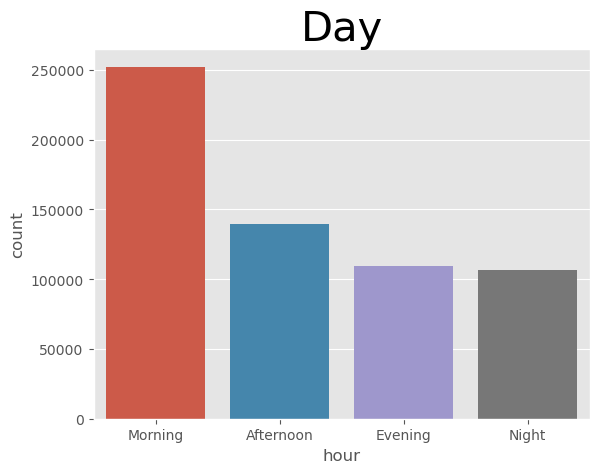

In [38]:
# Visualisasi menggunakan Matplotlib mengenai jumlah rides setiap waktu per hari
day = pd.cut(x=df['hour'],bins=[0,10,15,19,23],labels= ['Morning','Afternoon','Evening','Night'])
plt.title('Day',fontsize=30)
sns.countplot(x=day)
day

Dari output di atas, dapat diketahui bahwa jumlah rides paling banyak terjadi pada saat pagi hari.

price
7.00     52314
16.50    44351
10.50    40590
13.50    33707
9.00     30884
27.50    28221
19.50    26591
22.50    26568
26.00    26226
9.50     22738
11.00    21419
8.50     18270
7.50     17951
5.00     14084
8.00     13885
16.00    12654
15.00    12470
32.50    11496
11.50    11044
34.00     9792
30.00     7685
10.00     7069
14.00     6269
13.00     6225
12.00     6206
17.00     6122
12.50     5601
3.00      5543
38.50     5540
6.50      5390
3.50      5063
20.50     5027
27.00     4950
18.50     4936
26.50     4846
17.50     4576
29.50     4103
30.50     3701
21.50     3676
23.00     3628
25.00     3524
18.00     3264
24.00     3254
28.50     3159
38.00     2811
31.50     2686
15.50     2647
42.50     2393
5.50      2260
35.00     2148
22.00     1992
33.00     1978
28.00     1828
45.50     1716
14.50     1583
19.00     1452
32.00     1445
36.00     1426
23.50     1257
21.00     1138
29.00      894
33.50      852
31.00      810
37.00      745
47.50      704
6.00       666
39.5

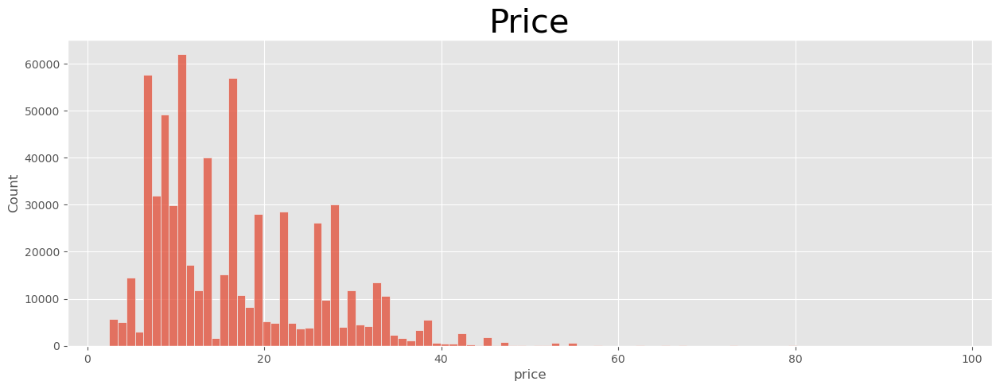

In [39]:
# Menampilkan distribusi harga menggunakan Matplotlib
bins = np.linspace(df['price'].min(),df['price'].max(),100)
count = df['price'].value_counts()
plt.figure(figsize=(15,5))
plt.title('Price',fontsize=30)
sns.histplot(x='price',data=df,bins=bins)
count

Dari output di atas, dapat diketahui bahwa harga 7.00 dolar memiliki frekuensi paling banyak, yaitu sebanyak 52.314.

hour
0     29872
23    29355
17    28075
12    28017
13    27977
14    27976
16    27972
18    27958
11    27946
10    27918
15    27868
22    27093
9     26673
2     26323
1     26310
4     26125
21    25549
3     25530
19    25410
6     25147
20    24620
5     22995
7     22930
8     22337
Name: count, dtype: int64

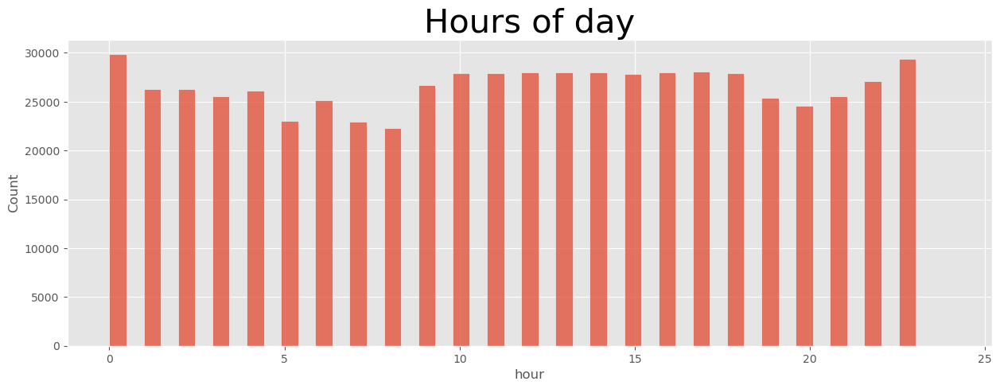

In [40]:
# Menampilkan distribusi menggunakan Matplotlib
bins = np.linspace(0,24)
count = df['hour'].value_counts()
plt.figure(figsize=(15,5))
plt.title('Hours of day',fontsize=30)
sns.histplot(x='hour',data=df,bins=bins)
count

Waktu dengan jumlah pengguna terbanyak adalah pada pukul 00.00 dan kedua adalah pukul 23.00, kemudian pada pukul 10.00 sampai pukul 18.00 pengguna terhitung stagnan atau tidak ada perbedaan yang signifikan.

day
27    70135
28    67842
29    55222
1     41680
30    41544
16    41359
17    41354
14    41344
15    41332
3     41323
2     41298
13    35496
18    33329
26    29028
4     11627
10     2534
9      1529
Name: count, dtype: int64

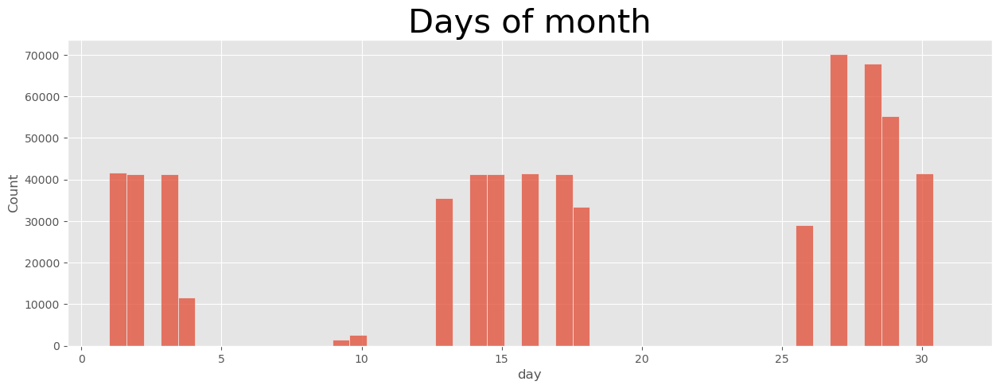

In [41]:
# Menampilkan jumlah hari dalam sebulan menggunakan Matplotlib
bins = np.linspace(1,31)
count = df['day'].value_counts()
plt.figure(figsize=(15,5))
plt.title('Days of month',fontsize=30)
sns.histplot(x='day',data=df,bins=bins)
count

Tanggal dengan jumlah rides terbanyak adalah 27 yang kemudian menurun pada hari-hari berikutnya. Kemudian pada tanggal awal dan tengah terlihat bahwa ada beberapa tanggal yang stagnan artinya tidak ada peningkatan ataupun penurunan, juga pada tanggal tertentu yang dapat dilihat di atas tidak ada aktivitas sama sekali.

([<matplotlib.patches.Wedge at 0x260b7bcff40>,
 [Text(0.6018112140505569, 0.9207731874044742, ' Overcast '),
  Text(-0.9679827366161721, 0.5225030350276126, ' Mostly Cloudy '),
  Text(-0.8085092001828758, -0.7458638436200314, ' Partly Cloudy '),
  Text(0.1608831273537352, -1.0881712270285786, ' Clear '),
  Text(0.7818592781941908, -0.7737545276776473, ' Light Rain '),
  Text(1.0024539027631545, -0.45286440888517665, ' Rain '),
  Text(1.0704086519843887, -0.25342714487000795, ' Possible Drizzle '),
  Text(1.0937014947240844, -0.11754590779054734, ' Foggy '),
  Text(1.0993968886073868, -0.036420891263085245, ' Drizzle ')],
 [Text(0.32826066220939465, 0.5022399204024404, '31.573%'),
  Text(-0.527990583608821, 0.2850016554696068, '21.098%'),
  Text(-0.4410050182815685, -0.4068348237927444, '18.375%'),
  Text(0.08775443310203737, -0.5935479420155882, '12.580%'),
  Text(0.4264686971968313, -0.4220479241878076, '7.914%'),
  Text(0.5467930378708115, -0.24701695030100543, '3.414%'),
  Text(0.58

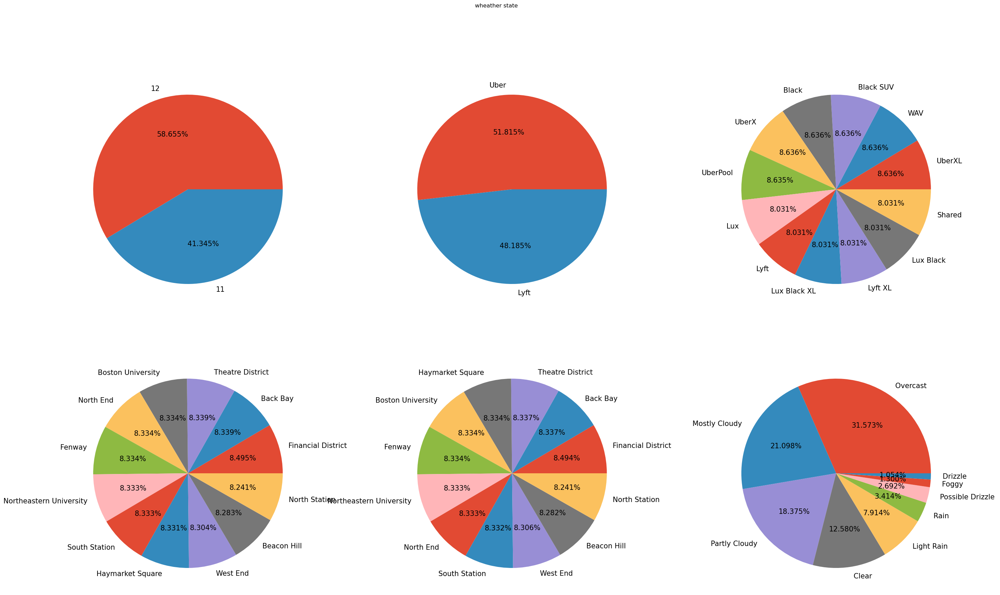

In [42]:
plt.figure(figsize=(35,20))
textprops = {"fontsize":15}
plt.subplot(2,3,1)
#show number of month
plt.suptitle('Number Of Month')
plt.pie(df['month'].value_counts(),labels=list(df['month'].value_counts().index),autopct ='%1.3f%%',textprops=textprops)
plt.subplot(2,3,2)
#show number of cab_type
plt.suptitle('Number Of cab_type')
plt.pie(df['cab_type'].value_counts(),labels=list(df['cab_type'].value_counts().index),autopct ='%1.3f%%',textprops=textprops)
plt.subplot(2,3,3)
#show number of name
plt.suptitle('Number Of cab_type')
plt.pie(df['name'].value_counts(),labels=list(df['name'].value_counts().index),autopct ='%1.3f%%',textprops=textprops)
plt.subplot(2,3,4)
#show number of source
plt.suptitle('Number Of Source')
plt.pie(df['source'].value_counts(),labels=list(df['source'].value_counts().index),autopct ='%1.3f%%',textprops=textprops)
plt.subplot(2,3,5)
#show number of destination
plt.suptitle('Number Of destination')
plt.pie(df['destination'].value_counts(),labels=list(df['destination'].value_counts().index),autopct ='%1.3f%%',textprops=textprops)
plt.subplot(2,3,6)
#show number of wheather state 
plt.suptitle('wheather state ')
plt.pie(df['short_summary'].value_counts(),labels=list(df['short_summary'].value_counts().index),autopct ='%1.3f%%',textprops=textprops)

Dari output di atas dapat diketahui bahwa bulan dengan nilai terbanyak adalah bulan 12 sebanyak 58.6%, jumlah pada kolom cab_type terbanyak adalah Uber sebanyak 51.8%, jumlah nama paling banyak adalah UberX, Black, Black SUV, WAV, dan UberXL yang memiliki nilai masing-masing sebanyak 8.6%, jumlah asal perjalanan paling banyak adalah dari Financial District sebesar 8.4%, jumlah tujuan paling banyak juga Financial District sebesar 8.4%, dan cuaca yang paling sering dijumpai adalah overcast sebesar 31.5%.

([<matplotlib.patches.Wedge at 0x260b7b36e30>,
 [Text(0.6018112140505569, 0.9207731874044742, ' cloudy '),
  Text(-0.994595128330795, 0.4698728878118525, ' partly-cloudy-night '),
  Text(-0.7673724848010052, -0.788124019155825, ' partly-cloudy-day '),
  Text(0.24557720635597322, -1.0722368375123081, ' rain '),
  Text(0.9088634135524151, -0.6196509465060568, ' clear-night '),
  Text(1.077370219583778, -0.22197614726362486, ' clear-day '),
  Text(1.0990831239157568, -0.04490308144862181, ' fog ')],
 [Text(0.32826066220939465, 0.5022399204024404, '31.573%'),
  Text(-0.542506433634979, 0.25629430244282864, '22.805%'),
  Text(-0.41856680989145734, -0.42988582863044994, '16.668%'),
  Text(0.13395120346689446, -0.5848564568248953, '15.074%'),
  Text(0.4957436801194991, -0.33799142536694, '8.711%'),
  Text(0.5876564834093333, -0.12107789850743172, '3.868%'),
  Text(0.5994998857722309, -0.02449258988106644, '1.300%')])

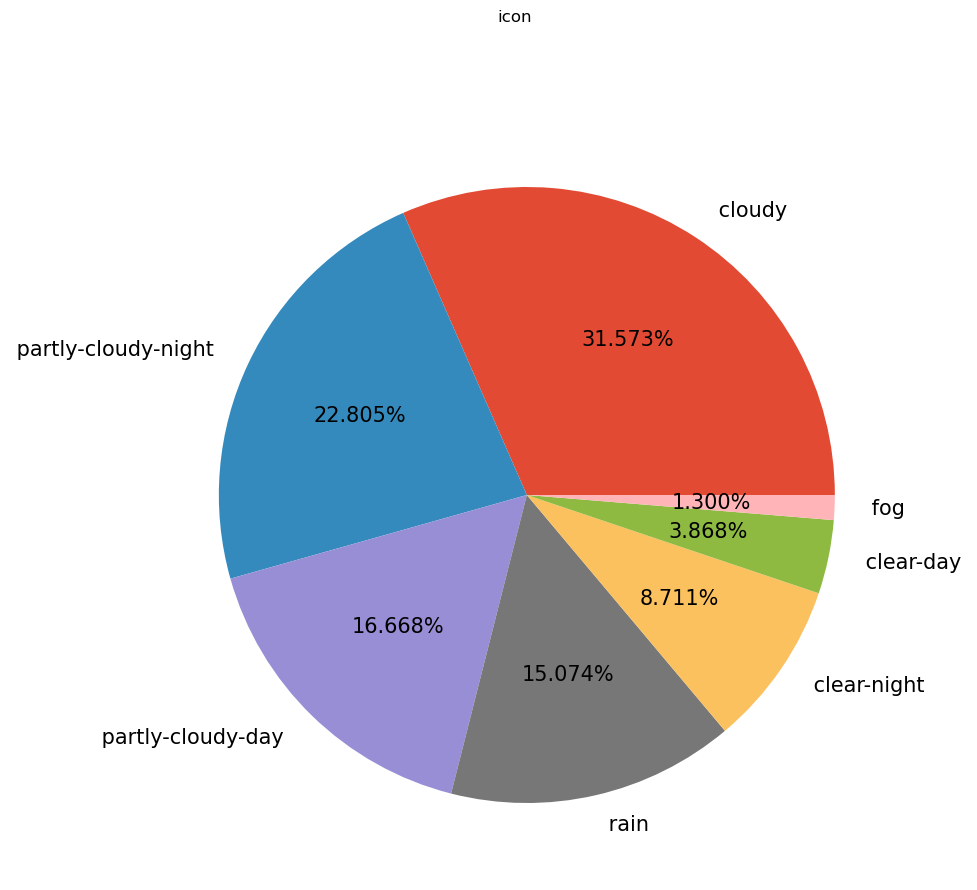

In [43]:
#show number of icon 
plt.figure(figsize=(10,10))
plt.suptitle('icon')
plt.pie(df['icon'].value_counts(),labels=list(df['icon'].value_counts().index),autopct ='%1.3f%%',textprops=textprops)

Dari output di atas, terlihat bahwa cuaca dengan jumlah pengguna terbanyak adalah cloudy dengan persentase sebanyak 31.5% dan disusul partly-cloudy-night dengan persentase sebanyak 22.8%.

Kita dapat melihat rata-rata dari harga setiap rute (asal-tujuan) melalui tabel di bawah ini.

In [44]:
pd.set_option('display.max_rows', 72)
df.groupby(by=["source","destination"]).price.agg(["mean"])

mean
source                  destination                       
Back Bay                Boston University        14.039392
                        Fenway                   13.658752
                        Haymarket Square         17.987384
                        North End                19.473019
                        Northeastern University  13.151040
                        South Station            17.700711
Beacon Hill             Boston University        16.376737
                        Fenway                   16.158840
                        Haymarket Square         13.799137
                        North End                15.270942
                        Northeastern University  16.471792
                        South Station            15.950661
Boston University       Back Bay                 13.992801
                        Beacon Hill              17.315535
                        Financial District       24.146085
                        North Station            20.185338
                        Theatre District         18.689557
                        West End                 18.611766
Fenway                  Back Bay                 13.802155
                        Beacon Hill              16.796674
                        Financial District       23.438818
                        North Station            19.701839
                        Theatre District         18.232722
                        West End                 18.161806
Financial District      Boston University        25.498434
                        Fenway                   23.404850
                        Haymarket Square         13.188209
                        North End                13.179635
                        Northeastern University  21.918584
                        South Station            12.349066
Haymarket Square        Back Bay                 16.860489
                        Beacon Hill              13.338559
                        Financial District       12.731618
                        North Station            12.332545
                        Theatre District         13.677272
                        West End                 12.529855
North End               Back Bay                 19.550935
                        Beacon Hill              15.982630
                        Financial District       13.417597
                        North Station            12.824092
                        Theatre District         15.169406
                        West End                 13.494873
North Station           Boston University        18.931558
                        Fenway                   18.547603
                        Haymarket Square         12.571791
                        North End                13.106641
                        Northeastern University  19.537848
                        South Station            15.374198
Northeastern University Back Bay                 13.698923
                        Beacon Hill              16.842433
                        Financial District       22.582094
                        North Station            19.910939
                        Theatre District         16.144805
                        West End                 18.204155
South Station           Back Bay                 19.103822
                        Beacon Hill              17.276304
                        Financial District       12.436910
                        North Station            15.746736
                        Theatre District         13.952579
                        West End                 15.881172
Theatre District        Boston University        20.360662
                        Fenway                   19.069278
                        Haymarket Square         15.204973
                        North End                15.159646
                        Northeastern University  16.910751
                        South Station            12.888926
West End                Boston University 

In [45]:
# Menampilkan harga maksimum dari dataset
print('Maximum price in our data:',df.price.max())
df[df['price']==df.price.max()]

Maximum price in our data: 97.5


,id,timestamp,hour,day,month,datetime,timezone,source,destination,cab_type,product_id,name,price,distance,surge_multiplier,latitude,longitude,temperature,apparentTemperature,short_summary,long_summary,precipIntensity,precipProbability,humidity,windSpeed,windGust,windGustTime,visibility,temperatureHigh,temperatureHighTime,temperatureLow,temperatureLowTime,apparentTemperatureHigh,apparentTemperatureHighTime,apparentTemperatureLow,apparentTemperatureLowTime,icon,dewPoint,pressure,windBearing,cloudCover,uvIndex,visibility.1,ozone,sunriseTime,sunsetTime,moonPhase,precipIntensityMax,uvIndexTime,temperatureMin,temperatureMinTime,temperatureMax,temperatureMaxTime,apparentTemperatureMin,apparentTemperatureMinTime,apparentTemperatureMax,apparentTemperatureMaxTime
597071,ba1593a1-e4fd-4c7a-a011-e2d4fccbf081,1.543714e+09,1,2,12,2018-12-02 01:28:02,America/New_York,Financial District,Fenway,Lyft,lyft_luxsuv,Lux Black XL,97.5,4.43,2.0,42.3503,-71.081,35.52,35.52,Clear,Light rain in the morning and overnight.,0.0,0.0,0.82,1.85,2.37,1543672800,9.846,44.65,1543690800,34.88,1543712400,43.98,1543690800,35.53,1543712400,clear-night,30.46,1023.52,146,0.12,0,9.846,274.6,1543665335,1543698860,0.82,0.0,1543683600,31.57,1543665600,44.65,1543690800,28.1,1543658400,43.98,1543690800


In [46]:
df[df['price']==df.price.max()] [['latitude','longitude']]

,latitude,longitude
597071,42.3503,-71.081


In [47]:
df_group = df.groupby(by=["source","destination"]).price.agg(["mean"]).reset_index()
df_group[(df_group['source']=='Financial District')& (df_group['destination']=='Fenway')]

,source,destination,mean
25,Financial District,Fenway,23.40485


Di bawah ini kita dapat melihat harga tertinggi dalam data adalah 97.5 dolar dengan lokasi latitude 42.3503 dan longitude -71.081 dengan rata-rata harga rute tersebut adalah 23.4 dolar yang jauh dari data harga maksimumnya, yaitu 97.5 dolar. Maka hal tersebut mungkin outlier sehingga bisa dihilangkan.

In [48]:
df = df.loc[df['price']!=df.price.max()]

In [49]:
df.head()

,id,timestamp,hour,day,month,datetime,timezone,source,destination,cab_type,product_id,name,price,distance,surge_multiplier,latitude,longitude,temperature,apparentTemperature,short_summary,long_summary,precipIntensity,precipProbability,humidity,windSpeed,windGust,windGustTime,visibility,temperatureHigh,temperatureHighTime,temperatureLow,temperatureLowTime,apparentTemperatureHigh,apparentTemperatureHighTime,apparentTemperatureLow,apparentTemperatureLowTime,icon,dewPoint,pressure,windBearing,cloudCover,uvIndex,visibility.1,ozone,sunriseTime,sunsetTime,moonPhase,precipIntensityMax,uvIndexTime,temperatureMin,temperatureMinTime,temperatureMax,temperatureMaxTime,apparentTemperatureMin,apparentTemperatureMinTime,apparentTemperatureMax,apparentTemperatureMaxTime
0,424553bb-7174-41ea-aeb4-fe06d4f4b9d7,1.544953e+09,9,16,12,2018-12-16 09:30:07,America/New_York,Haymarket Square,North Station,Lyft,lyft_line,Shared,5.0,0.44,1.0,42.2148,-71.033,42.34,37.12,Mostly Cloudy,Rain throughout the day.,0.0000,0.0,0.68,8.66,9.17,1545015600,10.000,43.68,1544968800,34.19,1545048000,37.95,1544968800,27.39,1545044400,partly-cloudy-night,32.70,1021.98,57,0.72,0,10.000,303.8,1544962084,1544994864,0.30,0.1276,1544979600,39.89,1545012000,43.68,1544968800,33.73,1545012000,38.07,1544958000
1,4bd23055-6827-41c6-b23b-3c491f24e74d,1.543284e+09,2,27,11,2018-11-27 02:00:23,America/New_York,Haymarket Square,North Station,Lyft,lyft_premier,Lux,11.0,0.44,1.0,42.2148,-71.033,43.58,37.35,Rain,"Rain until morning, starting again in the eve...",0.1299,1.0,0.94,11.98,11.98,1543291200,4.786,47.30,1543251600,42.10,1543298400,43.92,1543251600,36.20,1543291200,rain,41.83,1003.97,90,1.00,0,4.786,291.1,1543232969,1543266992,0.64,0.1300,1543251600,40.49,1543233600,47.30,1543251600,36.20,1543291200,43.92,1543251600
2,981a3613-77af-4620-a42a-0c0866077d1e,1.543367e+09,1,28,11,2018-11-28 01:00:22,America/New_York,Haymarket Square,North Station,Lyft,lyft,Lyft,7.0,0.44,1.0,42.2148,-71.033,38.33,32.93,Clear,Light rain in the morning.,0.0000,0.0,0.75,7.33,7.33,1543334400,10.000,47.55,1543320000,33.10,1543402800,44.12,1543320000,29.11,1543392000,clear-night,31.10,992.28,240,0.03,0,10.000,315.7,1543319437,1543353364,0.68,0.1064,1543338000,35.36,1543377600,47.55,1543320000,31.04,1543377600,44.12,1543320000
3,c2d88af2-d278-4bfd-a8d0-29ca77cc5512,1.543554e+09,4,30,11,2018-11-30 04:53:02,America/New_York,Haymarket Square,North Station,Lyft,lyft_luxsuv,Lux Black XL,26.0,0.44,1.0,42.2148,-71.033,34.38,29.63,Clear,Partly cloudy throughout the day.,0.0000,0.0,0.73,5.28,5.28,1543514400,10.000,45.03,1543510800,28.90,1543579200,38.53,1543510800,26.20,1543575600,clear-night,26.64,1013.73,310,0.00,0,10.000,291.1,1543492370,1543526114,0.75,0.0000,1543507200,34.67,1543550400,45.03,1543510800,30.30,1543550400,38.53,1543510800
4,e0126e1f-8ca9-4f2e-82b3-50505a09db9a,1.543463e+09,3,29,11,2018-11-29 03:49:20,America/New_York,Haymarket Square,North Station,Lyft,lyft_plus,Lyft XL,9.0,0.44,1.0,42.2148,-71.033,37.44,30.88,Partly Cloudy,Mostly cloudy throughout the day.,0.0000,0.0,0.70,9.14,9.14,1543446000,10.000,42.18,1543420800,36.71,1543478400,35.75,1543420800,30.29,1543460400,partly-cloudy-night,28.61,998.36,303,0.44,0,10.000,347.7,1543405904,1543439738,0.72,0.0001,1543420800,33.10,1543402800,42.18,1543420800,29.11,1543392000,35.75,1543420800


In [50]:
# Menampilkan map untuk maximum price
map_max = df[df['source']=='Financial District']
df_max = folium.Map(location=[map_max["latitude"].mean(), map_max["longitude"].mean()],zoom_start = 10)
df_max.add_child(FastMarkerCluster(map_max[['latitude', 'longitude']].values.tolist(),color='green'))
df_max

## Feature Selection

Tujuan kami adalah membuat model Linear Regression. Hal pertama, kami akan memeriksa korelasi antara fitur kami dengan fitur target (harga).

Pertama, kami ingin memeriksa korelasi fitur terkait suhu kami dengan fitur target kami (harga).

In [51]:
temp_cols= ['temperature','apparentTemperature','temperatureHigh','temperatureLow','apparentTemperatureHigh',
            'apparentTemperatureLow','temperatureMin','temperatureHighTime','temperatureMax',
            'apparentTemperatureMin','apparentTemperatureMax','price']

In [52]:
df_temp = df[temp_cols]
df_temp.head()

,temperature,apparentTemperature,temperatureHigh,temperatureLow,apparentTemperatureHigh,apparentTemperatureLow,temperatureMin,temperatureHighTime,temperatureMax,apparentTemperatureMin,apparentTemperatureMax,price
0,42.34,37.12,43.68,34.19,37.95,27.39,39.89,1544968800,43.68,33.73,38.07,5.0
1,43.58,37.35,47.30,42.10,43.92,36.20,40.49,1543251600,47.30,36.20,43.92,11.0
2,38.33,32.93,47.55,33.10,44.12,29.11,35.36,1543320000,47.55,31.04,44.12,7.0
3,34.38,29.63,45.03,28.90,38.53,26.20,34.67,1543510800,45.03,30.30,38.53,26.0
4,37.44,30.88,42.18,36.71,35.75,30.29,33.10,1543420800,42.18,29.11,35.75,9.0


<Axes: >

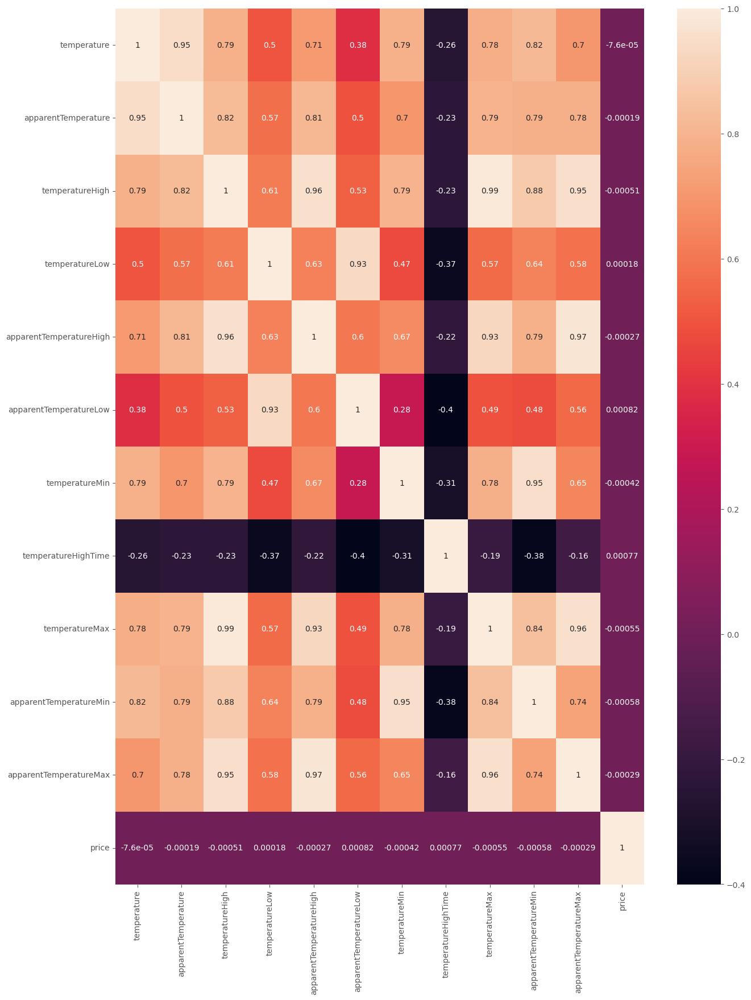

In [53]:
plt.figure(figsize=(15,20))
sns.heatmap(df_temp.corr(),annot=True)

Terlihat bahwa pada data yang berhubungan dengan temperature rendah korelasinya

Selanjutnya, kami akan menghapus semua yang tidak akan berdampak pada model Linear Regression kami seperti di bawah ini.

In [54]:
df = df.drop(['temperature','apparentTemperature','temperatureHigh','temperatureLow','apparentTemperatureHigh',
            'apparentTemperatureLow','temperatureMin','temperatureHighTime','temperatureMax',
            'apparentTemperatureMin','apparentTemperatureMax'],axis=1)
df.shape

(637975, 46)

Kedua, kami ingin memeriksa korelasi fitur terkait climate kami dengan fitur target kami (harga).

In [55]:
climate_column = ['precipIntensity', 'precipProbability', 'humidity', 'windSpeed',
                  'windGust', 'visibility', 'dewPoint', 'pressure', 'windBearing',
                  'cloudCover', 'uvIndex', 'ozone', 'moonPhase',
                  'precipIntensityMax','price']
df_clim = df[climate_column]
df_clim.head()

,precipIntensity,precipProbability,humidity,windSpeed,windGust,visibility,dewPoint,pressure,windBearing,cloudCover,uvIndex,ozone,moonPhase,precipIntensityMax,price
0,0.0000,0.0,0.68,8.66,9.17,10.000,32.70,1021.98,57,0.72,0,303.8,0.30,0.1276,5.0
1,0.1299,1.0,0.94,11.98,11.98,4.786,41.83,1003.97,90,1.00,0,291.1,0.64,0.1300,11.0
2,0.0000,0.0,0.75,7.33,7.33,10.000,31.10,992.28,240,0.03,0,315.7,0.68,0.1064,7.0
3,0.0000,0.0,0.73,5.28,5.28,10.000,26.64,1013.73,310,0.00,0,291.1,0.75,0.0000,26.0
4,0.0000,0.0,0.70,9.14,9.14,10.000,28.61,998.36,303,0.44,0,347.7,0.72,0.0001,9.0


<Axes: >

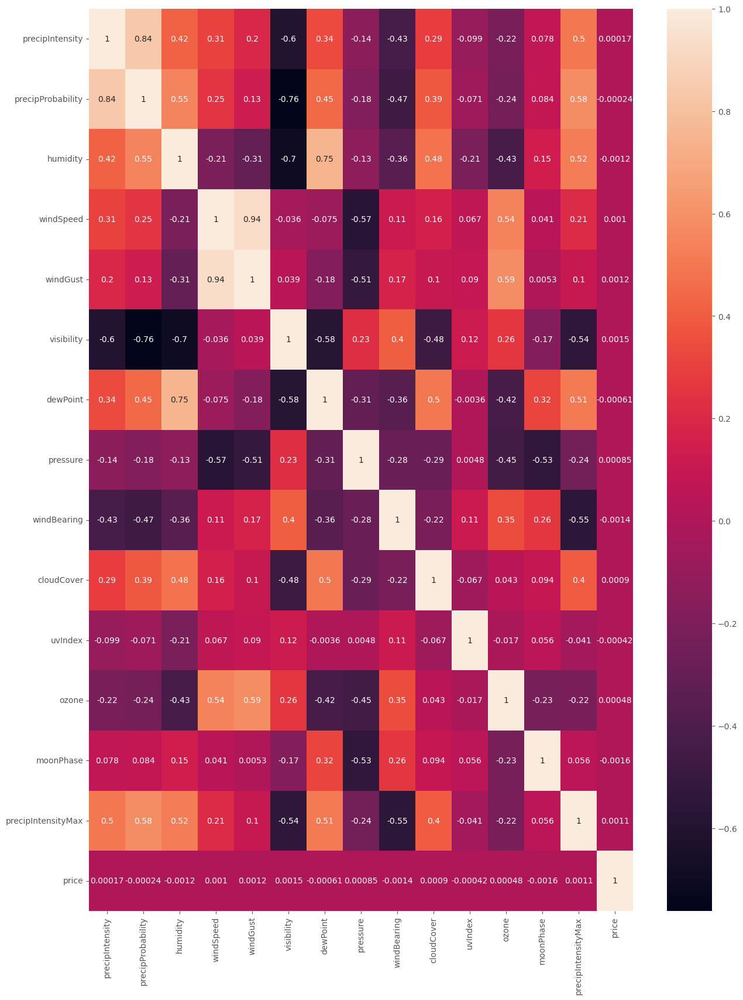

In [56]:
plt.figure(figsize=(15,20))
sns.heatmap(df_clim.corr(),annot=True)

Terlihat bahwa pada data yang berhubungan dengan climate data rendah korelasinya

### Menghapus Fitur yang Tidak Perlu

Pada fitur tanggal kami tidak memerlukannya, tetapi mungkin dalam beberapa waktu ke depan akan dibutuhkan sehingga kami membuat dataframe baru. Kami akan menghapus semua kolom yang tidak ada korelasinya dengan kolom harga dan tidak akan berdampak ada model Linear Regression kami.

In [58]:
new_df = df.drop(['id','timestamp','datetime','long_summary','apparentTemperatureHighTime','apparentTemperatureLowTime',
                  'apparentTemperatureLowTime','windGustTime','sunriseTime','sunsetTime','uvIndexTime','temperatureMinTime',
                  'temperatureMaxTime','apparentTemperatureMinTime','temperatureLowTime','apparentTemperatureMaxTime', 
                  'precipIntensity', 'precipProbability', 'humidity', 'windSpeed', 'windGust', 'visibility', 'visibility.1', 'dewPoint', 
                  'pressure', 'windBearing', 'cloudCover', 'uvIndex', 'ozone', 'moonPhase', 'precipIntensityMax'],axis=1)

In [59]:
new_df.shape

(637975, 16)

Ketiga, kami ingin memeriksa nilai kategoris kami dalam fitur dataset kami.

In [60]:
category_col = new_df.select_dtypes(include=['object','category']).columns.tolist()
for column in new_df[category_col]:
    print(f'{column} : {new_df[column].unique()}')
    print()

timezone : ['America/New_York']

source : ['Haymarket Square' 'Back Bay' 'North End' 'North Station' 'Beacon Hill'
 'Boston University' 'Fenway' 'South Station' 'Theatre District'
 'West End' 'Financial District' 'Northeastern University']

destination : ['North Station' 'Northeastern University' 'West End' 'Haymarket Square'
 'South Station' 'Fenway' 'Theatre District' 'Beacon Hill' 'Back Bay'
 'North End' 'Financial District' 'Boston University']

cab_type : ['Lyft' 'Uber']

product_id : ['lyft_line' 'lyft_premier' 'lyft' 'lyft_luxsuv' 'lyft_plus' 'lyft_lux'
 '6f72dfc5-27f1-42e8-84db-ccc7a75f6969'
 '6c84fd89-3f11-4782-9b50-97c468b19529'
 '55c66225-fbe7-4fd5-9072-eab1ece5e23e'
 '9a0e7b09-b92b-4c41-9779-2ad22b4d779d'
 '6d318bcc-22a3-4af6-bddd-b409bfce1546'
 '997acbb5-e102-41e1-b155-9df7de0a73f2']

name : ['Shared' 'Lux' 'Lyft' 'Lux Black XL' 'Lyft XL' 'Lux Black' 'UberXL'
 'Black' 'UberX' 'WAV' 'Black SUV' 'UberPool']

short_summary : [' Mostly Cloudy ' ' Rain ' ' Clear ' ' Partly Clou

Dapat dilihat bahwa fitur 'timezone' hanya memiliki 1 nilai dan fitur 'product_id' berisi banyak nilai yang tidak teridentifikasi. Jadi, kami dapat menghapus atau men-drop.

In [61]:
# Men-drop kolom timezone dan product_id
new_df = new_df.drop(['timezone','product_id'],axis=1)

In [62]:
new_df.shape

(637975, 14)

Keempat, kami ingin memeriksa korelasi fitur kategoris kami dengan fitur target kami (harga).

In [63]:
new_cat = ['source','destination','cab_type','name','short_summary','icon','price']

df_cat = new_df[new_cat]
df_cat.head()

,source,destination,cab_type,name,short_summary,icon,price
0,Haymarket Square,North Station,Lyft,Shared,Mostly Cloudy,partly-cloudy-night,5.0
1,Haymarket Square,North Station,Lyft,Lux,Rain,rain,11.0
2,Haymarket Square,North Station,Lyft,Lyft,Clear,clear-night,7.0
3,Haymarket Square,North Station,Lyft,Lux Black XL,Clear,clear-night,26.0
4,Haymarket Square,North Station,Lyft,Lyft XL,Partly Cloudy,partly-cloudy-night,9.0


### Menghapus Outliers

Kami menggunakan metode IQR untuk memeriksa outlier atas dan bawah.

In [64]:
Qp12 = new_df['price'].quantile(0.25)
Qp32 = new_df['price'].quantile(0.75)
IQRp = Qp32-Qp12

In [65]:
new_df[new_df['price']>(Qp32+(1.5*IQRp))]

,hour,day,month,source,destination,cab_type,name,price,distance,surge_multiplier,latitude,longitude,short_summary,icon
706,10,28,11,South Station,Back Bay,Lyft,Lux Black,52.5,3.25,2.00,42.3661,-71.0631,Partly Cloudy,partly-cloudy-night
707,2,16,12,South Station,Back Bay,Lyft,Lux Black XL,67.5,3.25,2.00,42.3505,-71.1054,Partly Cloudy,partly-cloudy-night
769,17,14,12,Theatre District,Boston University,Lyft,Lux Black XL,45.5,4.76,1.00,42.3503,-71.0810,Partly Cloudy,partly-cloudy-day
1094,17,2,12,Theatre District,Fenway,Lyft,Lux Black XL,45.5,4.31,1.00,42.3503,-71.0810,Light Rain,rain
1318,16,16,12,Financial District,Boston University,Lyft,Lux Black XL,45.5,5.33,1.00,42.3661,-71.0631,Overcast,cloudy
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
692439,20,17,12,Financial District,Boston University,Uber,Black SUV,47.0,5.56,1.00,42.3588,-71.0707,Mostly Cloudy,partly-cloudy-day
692698,10,14,12,Financial District,Fenway,Lyft,Lux Black XL,52.5,4.58,1.25,42.3519,-71.0643,Partly Cloudy,partly-cloudy-night
692891,5,3,12,Financial District,Boston University,Lyft,Lux Black XL,47.5,5.42,1.00,42.3398,-71.0892,Foggy,fog
692962,4,2,12,Back Bay,North End,Uber,Black SUV,51.0,7.36,1.00,42.3661,-71.0631,Mostly Cloudy,partly-cloudy-night


In [66]:
new_df[new_df['price']<(Qp12-(1.5*IQRp))]

,hour,day,month,source,destination,cab_type,name,price,distance,surge_multiplier,latitude,longitude,short_summary,icon


Dari output tersebut, kami dapat melihat bahwa terdapat 5.588 outlier data. Dengan begitu, kami dapat menghapus atau men-drop data tersebut.

In [67]:
print('Size before removing:', new_df.shape)
new_df = new_df[~((new_df['price']>(Qp32+(1.5*IQRp))))]
print('Size after removing:', new_df.shape)

Size before removing: (637975, 14)
Size after removing: (632387, 14)


### Encoding Data (One Hot Encoding)

In [68]:
def one_hot_encorder(data,feature,keep_first=True):

    one_hot_cols = pd.get_dummies(data[feature])

    for col in one_hot_cols.columns:
        one_hot_cols.rename({col:f'{feature}_'+col},axis=1, inplace=True)
    
    new_data = pd.concat([data,one_hot_cols],axis=1)
    new_data.drop(feature,axis=1,inplace=True)

    if keep_first == False:
        new_data = new_data.iloc[:,1:]

    return new_data

In [69]:
new_df_onehot = new_df.copy()
for col in new_df_onehot.select_dtypes(include='O').columns:
    new_df_onehot = one_hot_encorder(new_df_onehot,col)

new_df_onehot.head()

,hour,day,month,price,distance,surge_multiplier,latitude,longitude,source_Back Bay,source_Beacon Hill,source_Boston University,source_Fenway,source_Financial District,source_Haymarket Square,source_North End,source_North Station,source_Northeastern University,source_South Station,source_Theatre District,source_West End,destination_Back Bay,destination_Beacon Hill,destination_Boston University,destination_Fenway,destination_Financial District,destination_Haymarket Square,destination_North End,destination_North Station,destination_Northeastern University,destination_South Station,destination_Theatre District,destination_West End,cab_type_Lyft,cab_type_Uber,name_Black,name_Black SUV,name_Lux,name_Lux Black,name_Lux Black XL,name_Lyft,name_Lyft XL,name_Shared,name_UberPool,name_UberX,name_UberXL,name_WAV,short_summary_ Clear,short_summary_ Drizzle,short_summary_ Foggy,short_summary_ Light Rain,short_summary_ Mostly Cloudy,short_summary_ Overcast,short_summary_ Partly Cloudy,short_summary_ Possible Drizzle,short_summary_ Rain,icon_ clear-day,icon_ clear-night,icon_ cloudy,icon_ fog,icon_ partly-cloudy-day,icon_ partly-cloudy-night,icon_ rain
0,9,16,12,5.0,0.44,1.0,42.2148,-71.033,False,False,False,False,False,True,False,False,False,False,False,False,False,False,False,False,False,False,False,True,False,False,False,False,True,False,False,False,False,False,False,False,False,True,False,False,False,False,False,False,False,False,True,False,False,False,False,False,False,False,False,False,True,False
1,2,27,11,11.0,0.44,1.0,42.2148,-71.033,False,False,False,False,False,True,False,False,False,False,False,False,False,False,False,False,False,False,False,True,False,False,False,False,True,False,False,False,True,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,True,False,False,False,False,False,False,True
2,1,28,11,7.0,0.44,1.0,42.2148,-71.033,False,False,False,False,False,True,False,False,False,False,False,False,False,False,False,False,False,False,False,True,False,False,False,False,True,False,False,False,False,False,False,True,False,False,False,False,False,False,True,False,False,False,False,False,False,False,False,False,True,False,False,False,False,False
3,4,30,11,26.0,0.44,1.0,42.2148,-71.033,False,False,False,False,False,True,False,False,False,False,False,False,False,False,False,False,False,False,False,True,False,False,False,False,True,False,False,False,False,False,True,False,False,False,False,False,False,False,True,False,False,False,False,False,False,False,False,False,True,False,False,False,False,False
4,3,29,11,9.0,0.44,1.0,42.2148,-71.033,False,False,False,False,False,True,False,False,False,False,False,False,False,False,False,False,False,False,False,True,False,False,False,False,True,False,False,False,False,False,False,False,True,False,False,False,False,False,False,False,False,False,False,False,True,False,False,False,False,False,False,False,True,False


In [70]:
# Dataset split
X = new_df_onehot.drop(columns=['price'],axis=1).values
y = new_df_onehot['price'].values

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3, random_state=0)

## Data Preprocessing

In [71]:
le = preprocessing.LabelEncoder()

In [72]:
df_cat_encode = df_cat.copy()
for col in df_cat_encode.select_dtypes(include='O').columns:
    df_cat_encode[col]=le.fit_transform(df_cat_encode[col])

In [73]:
df_cat_encode

,source,destination,cab_type,name,short_summary,icon,price
0,5,7,0,7,4,5,5.0
1,5,7,0,2,8,6,11.0
2,5,7,0,5,0,1,7.0
3,5,7,0,4,0,1,26.0
4,5,7,0,6,6,5,9.0
...,...,...,...,...,...,...,...
693065,11,6,1,11,6,5,9.5
693066,11,6,1,10,6,5,13.0
693067,11,6,1,9,6,5,9.5
693069,11,6,1,1,6,5,27.0


<Axes: >

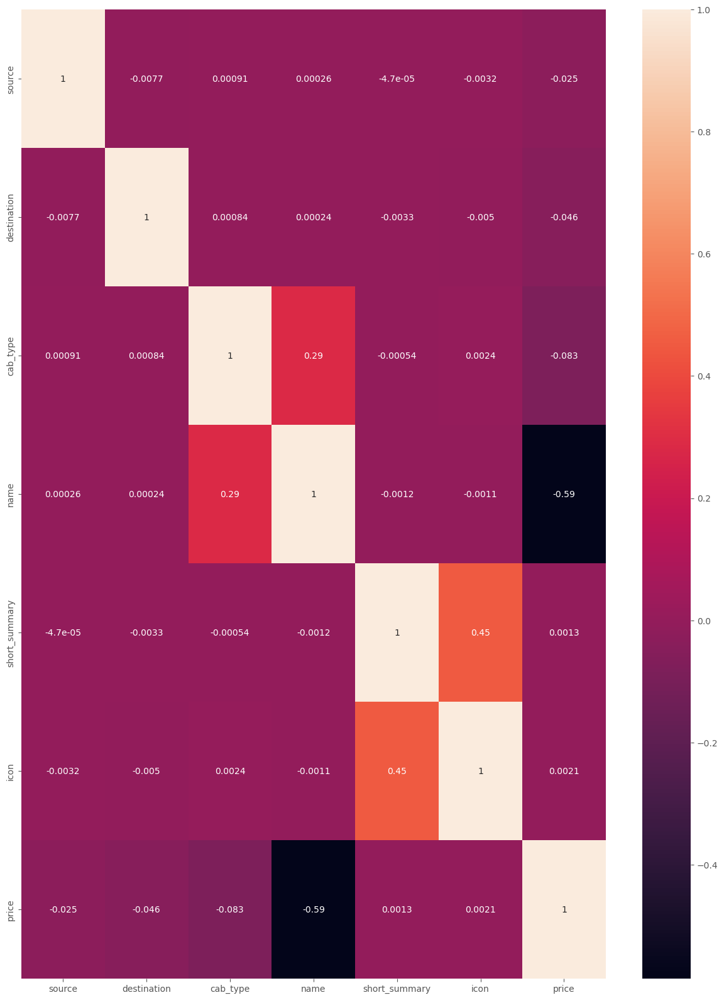

In [74]:
plt.figure(figsize=(15,20))
sns.heatmap(df_cat_encode.corr(),annot=True)

Dapat dilihat bahwa hanya fitur name yang memiliki korelasi yang relatif kuat. Fitur source, destination, dan cab_type memiliki korelasi yang relatif lemah, tetapi kami akan memilih fitur cab_type karena memiliki korelasi yang lebih kuat daripada dua fitur lainnya. Kami akan men-drop atau menghapus sisa kolom yang ada.

In [75]:
new_df = new_df.drop(['source','destination','short_summary','icon'],axis=1)
new_df.head()

,hour,day,month,cab_type,name,price,distance,surge_multiplier,latitude,longitude
0,9,16,12,Lyft,Shared,5.0,0.44,1.0,42.2148,-71.033
1,2,27,11,Lyft,Lux,11.0,0.44,1.0,42.2148,-71.033
2,1,28,11,Lyft,Lyft,7.0,0.44,1.0,42.2148,-71.033
3,4,30,11,Lyft,Lux Black XL,26.0,0.44,1.0,42.2148,-71.033
4,3,29,11,Lyft,Lyft XL,9.0,0.44,1.0,42.2148,-71.033


Juga kami akan menghapus kolom hour, day, month, latitude dan longitude karena kami tidak akan membutuhkannya untuk saat ini.

In [76]:
new_df = new_df.drop(['hour','day','month','latitude','longitude'],axis=1)
new_df.head()

,cab_type,name,price,distance,surge_multiplier
0,Lyft,Shared,5.0,0.44,1.0
1,Lyft,Lux,11.0,0.44,1.0
2,Lyft,Lyft,7.0,0.44,1.0
3,Lyft,Lux Black XL,26.0,0.44,1.0
4,Lyft,Lyft XL,9.0,0.44,1.0


In [77]:
new_df.columns

Index(['cab_type', 'name', 'price', 'distance', 'surge_multiplier'], dtype='object')

Tersisa 5 kolom yang akan kami gunakan untuk pemodelan karena memiliki korelasi yang baik.

## Pendefinisian Model

In [78]:
reg = LinearRegression()

## Pelatihan Model

In [79]:
model = reg.fit(X_train,y_train)
y_pred = model.predict(X_test)

In [80]:
# nilai intercept
print(("nilai intercept:"),model.intercept_)

# nilai koefisien
print(("nilai koefisien:"),reg.coef_)

nilai intercept: -459571000344.953
nilai koefisien: [ 6.72517883e-04 -7.36930977e-04 -7.54508472e-03  2.75292168e+00
  1.37779143e+01  2.28768726e-01  1.23750622e-01  8.71318447e+10
  8.71318447e+10  4.31465684e+11  4.31465684e+11  8.71318447e+10
  4.31465684e+11  4.31465684e+11  8.71318447e+10  4.31465684e+11
  4.31465684e+11  8.71318447e+10  8.71318447e+10  5.74266707e+09
  5.74266707e+09  3.50076507e+11  3.50076507e+11  5.74266707e+09
  3.50076507e+11  3.50076507e+11  5.74266707e+09  3.50076507e+11
  3.50076507e+11  5.74266707e+09  5.74266707e+09 -3.90324909e+10
 -2.49745533e+11  1.73638779e+11  1.73638779e+11 -3.70742626e+10
 -3.70742626e+10 -3.70742625e+10 -3.70742626e+10 -3.70742626e+10
 -3.70742626e+10  1.73638779e+11  1.73638779e+11  1.73638779e+11
  1.73638779e+11  8.42729584e+10  1.29889772e+11  1.38114710e+10
  1.29889772e+11  1.60745190e+11  7.47760697e+10  1.60745190e+11
  1.29889772e+11  1.29889772e+11  1.41964439e+10  1.41964439e+10
  2.36933326e+10  8.46579314e+10 -6.22

In [82]:
lr_mse = mean_squared_error(y_test,y_pred)
lr_rmse = np.sqrt(lr_mse)
print('Linear Regression MSE: %.4f' % lr_mse)
print('Linear Regression RMSE: %.4f' % lr_rmse)

Linear Regression MSE: 5.0263
Linear Regression RMSE: 2.2419


In [83]:
# Linear Regression
r2_lr_train = model.score(X_train, y_train)
r2_lr_test = model.score(X_test, y_test)
# Melihat nilai r-square dari nilai testing dan training
print(("Nilai R-squared Training Linear Regression:"),r2_lr_train)
print(("Nilai R-squared Testing Linear Regression:"),r2_lr_test)

Nilai R-squared Training Linear Regression: 0.9343010100530938
Nilai R-squared Testing Linear Regression: 0.9348432744478022


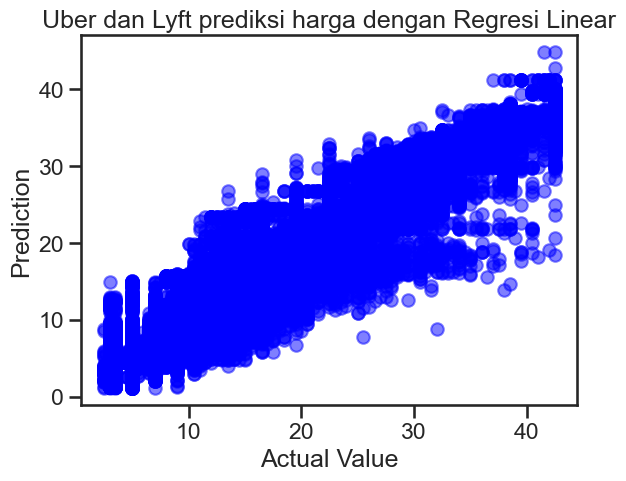

In [84]:
sns.set_context('talk')
sns.set_style('ticks')
sns.set_palette('dark')

ax = plt.axes()

ax.scatter(y_test, y_pred, alpha=.5, color='blue')

ax.set(xlabel='Actual Value', 
       ylabel='Prediction',
       title='Uber dan Lyft prediksi harga dengan Regresi Linear');

Berdasarkan visualisasi scatter plot di atas, terlihat perbedaan dari actual value terhadap prediction membentuk pola garis lurus dari kiri bawah naik ke kanan atas mengindikasikan kedua data train dan test berelasi positif.

## Evaluasi Model

In [87]:
r2_score(y_test, y_pred)

0.9348432744478022

In [88]:
mse = mean_squared_error(y_test,y_pred)
rmse = np.sqrt(mse)
print(mse)
print(rmse)

5.026276244364476
2.2419358252109887


Kemudian untuk perjalanan panjang yang telah kami lakukan, kami mendapatkan model regresi kami dengan akurasi atau skor 93.48% dan nilai RMSE sebanyak 2.26.

## Model Inference

In [89]:
new_df.head()

,cab_type,name,price,distance,surge_multiplier
0,Lyft,Shared,5.0,0.44,1.0
1,Lyft,Lux,11.0,0.44,1.0
2,Lyft,Lyft,7.0,0.44,1.0
3,Lyft,Lux Black XL,26.0,0.44,1.0
4,Lyft,Lyft XL,9.0,0.44,1.0


In [97]:
price_predict_lr = model.predict(X_train)
print('Prediksi Harga Transportasi Online Dengan Linear Regression: ')
print(price_predict_lr)

Prediksi Harga Transportasi Online Dengan Linear Regression: 
[17.27905273 19.90991211 10.1998291  ... 10.00933838 14.5546875
 32.06829834]


## Kesimpulan

In [98]:
print(("Nilai R-squared Training Linear Regression:"),r2_lr_train)
print(("Nilai R-squared Testing Linear Regression:"),r2_lr_test)

Nilai R-squared Training Linear Regression: 0.9343010100530938
Nilai R-squared Testing Linear Regression: 0.9348432744478022


Nilai akurasi Linear Regression menggunakan Logistic Regression sebesar 93% dan faktor yang paling berpengaruh dalam penentuan harga adalah distance dan surge multiplier yang memiliki tingkat korelasi tinggi.